<h1>Clustering of the Island of Montreal</h1>

<h1>Table of contents</h1>

* [Introduction](#introduction)
* [Data collection](#data)
* [Data exploratory analysis](#exploratory)
* [Clustering](#clustering)
* [Comparison between the models](#comparison)
* [Clustering results](#results)
* [Discussion](#discussion)
* [Conclusion](#conclusion)

<h1>Introduction: Business Problem <a name="introduction"></a></h1>

The neighborhoods of a city, especially the large ones, may be very different; the population, the real estate and the accessible venues can vary a lot even within the same area. However, most of the neighborhoods share a lot of characteristics with others. Therefore to have a quick and easy to understand description of a city, it would be interesting to identify the different kinds of neighborhoods and to associate all of them to a specific profile. This project aims to help people who want to move in to select the best place or people who want to start a business to select the best location. This study is addressing this issue for Montreal.

**The project aims to cluster the Island of Montreal into similar neighborhoods based on the environment (density of restaurants, bars, cultural activities, schools, ...), the population (density of population, age, income, ...) and the housing (value, type of dwellings, ...).** For each of these categories, a set of specific features is selected and a clustering method is used to gather the similar neighborhoods. Three clustering approaches are considered and implemented: K-Means, DBSCAN and agglomerative clustering, and the results are compared to identify the best method.

First, the data sources used for this project are presented, as well as the required data cleaning and preprocessing. An exploratory data analysis is conducted to highlight some preliminary observations about the collected data. Then for the three clustering approaches considered, a short description and a parameters selection is performed and the results are used to compare the methods. Finally, the clusters obtained with the best approach are described and analysed.

# Data collection <a name="data"></a>

In the context of this project, the considered subdivision of the Island of Montreal is the Forward Sortation Area (FSA), the first three characters of a postal code. Different datasets and APIs are used to get relevant data about each FSA.

## Data cleaning

In [2]:
# Import the libraries

import pandas as pd
import numpy as np
import json
import folium
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
import matplotlib.pyplot as plt
from matplotlib.ticker import PercentFormatter
from yellowbrick.cluster import KElbowVisualizer
from sklearn.neighbors import NearestNeighbors
import scipy.cluster.hierarchy as shc
from sklearn.decomposition import PCA

### Correspondence between the FSAs of 2016 and 2020

The map of the FSAs has evolved between 2016 and 2020, the boundaries of some FSAs have shifted and new FSAs have been created. As we are using data from 2016 and 2020, we need to create FSA groups to have similar territories for all datasets.

In [3]:
def process_fsa(fsa, year):
    # Process FSAs to get the corresponding FSA group
    if year == 2020:
        fsas = {'H3A': 'H3A-H3B', 'H3B': 'H3A-H3B',
                'H8S': 'H8S-H8T', 'H8T': 'H8S-H8T',
                'H9J': 'H9J-H9K', 'H9K': 'H9J-H9K',
                'H4Y': 'H9P', 'H9P': 'H9P',
                'H5B': 'H2Z',
                'H5A': 'H3A-H3B', 'H4Z': 'H3A-H3B',
                'H4R': 'H4R-H4S-H4T', 'H4S': 'H4R-H4S-H4T', 'H4T': 'H4R-H4S-H4T'}
    if year == 2016:
        fsas = {'H3A': 'H3A-H3B', 'H3B': 'H3A-H3B',
                'H8S': 'H8S-H8T', 'H8T': 'H8S-H8T',
                'H9J': 'H9J-H9K', 'H9K': 'H9J-H9K',
                'H4R': 'H4R-H4S-H4T', 'H4S': 'H4R-H4S-H4T'}
    if fsa in fsas:
        return fsas[fsa]
    else:
        return fsa

### Foursquare

The  Foursquare  API  is  used  to  obtain  all  venues  in  a  specific  FSA. A python code build a dataset containing the information of the venues of all FSAs using this API. We get this dataset and clean it for the project.
For the need of this project, the venues must be gathered in categories. Foursquare already provides a category for the venues, but it is too specific. That is why we create general categories and link them to the Foursquare categories.

In [4]:
def process_categories(category_name):
    # Group the foursquare data into general categories
    
    # Restaurant and Bar
    restaurant = ['restaurant', 'bar', 'café', 'cafe', 'coffee', 'pizza', 'sandwich', 'breakfast spot', 'ice cream',
                  'frozen yogurt', 'speakeasy', 'nightlife', 'diner', 'lounge', 'joint', 'snack', 'bistro', 'food truck',
                  'brewery', 'strip club', 'pub', 'nightclub', 'food court', 'steakhouse', 'tea room', 'taco', 'castle',
                  'creperie', 'buffet', 'food service', 'bath house', 'poke place', 'soup place', 'club house',
                  'fish & chips', 'burrito', 'poutine', 'noodle', 'brasserie', 'well', 'salad place', 'beer garden']
    for r in restaurant:
        if r in str(category_name).lower() and str(category_name) not in ['Salon / Barbershop', 'Piano Bar', 'Public Art']:
            return 'RestaurantBar'
    
    # Entertainment
    entertainment = ['museum', 'theater', 'entertainment', 'event space', 'art gallery', 'performing', 'public art',
                     'art studio', 'library', 'design', 'music venue', 'comedy', 'photography', 'sculpture',
                     'convention center', 'arcade', 'bowling', 'recreation', 'rock', 'jazz', 'concert', 'auditorium',
                     'water', 'monument', 'lighthouse', 'exhibit', 'planetarium', 'recording studio', 'memorial site',
                     'piano', 'circus', 'zoo', 'massage', 'casino', 'play area']
    for e in entertainment:
        if e in str(category_name).lower() and 'college' not in str(category_name).lower() or str(category_name) == 'Spa':
            return 'EntertainmentCulture'
    
    # Sports
    sports = ['pool', 'gym', 'sports', 'field', 'studio', 'court', 'rink', 'golf', 'arena', 'track', 'stadium',
              'skate', 'range', 'dojo', 'curling']
    for s in sports:
        if s in str(category_name).lower():
            return 'Sports'
    
    # Outdoor
    outdoor = ['park', 'outdoor', 'scenic lookout', 'site', 'garden', 'marina', 'boat', 'plaza', 'trail', 'mountain', 'surf',
               'campground', 'lake', 'beach', 'rest area', 'vineyard', 'forest', 'nature', 'cave', 'fishing', 'rafting']
    for o in outdoor:
        if o in str(category_name).lower():
            return 'Outdoor'
    
    # All other
    if pd.isna(category_name):
        category = 'Other'

    return 'Other'

In [5]:
# Export the foursquare dataset
foursquare = pd.read_csv('../data/foursquare/all.csv')

# Drop duplicates
foursquare.drop_duplicates(subset = 'id', inplace=True, ignore_index=True)

# Get the general categories
foursquare['Category'] = foursquare['category_name'].apply(process_categories)

# Process the FSA to make correspondance between 2016 and 2020
foursquare['FSA'] = foursquare['FSA'].apply(lambda x: process_fsa(x, 2020))

# Group by categories to get the number of venues for each category per FSA
foursquare = foursquare[['FSA', 'id', 'Category']].groupby(['FSA', 'Category']).agg(NbVenue=('id','count')).reset_index()
foursquare.head()

,FSA,Category,NbVenue
0,H1A,EntertainmentCulture,3
1,H1A,Other,67
2,H1A,Outdoor,10
3,H1A,RestaurantBar,7
4,H1A,Sports,9


### STM

Portail données ouvertes Montréal is the City of Montreal's open data portal. It is used to access the map of bus and metro routes of the STM, the transportation company of Montreal. Using QGIS software, we isolate the name and coordinates of all metro stations. Then, in a python code, we use the reverse function of the Nominatim GeoPy's geocoder to get the address and the FSA of the metro stations from their coordinates. Finally, a dataset with the name, coordinates and FSA of the metro stations is built and read here.

In [6]:
# Read the CSV file with the metro stations per FSA
metro_stations = pd.read_csv('../data/metro/metro_stations.csv', index_col=0)

# Process the FSA to make correspondance between 2016 and 2020
metro_stations['FSA'] = metro_stations['FSA'].apply(lambda x: process_fsa(x, 2020))

# Group by FSA to get the number of stations per FSA
metro_stations = metro_stations.groupby(['FSA']).agg(MetroStations=('Name', 'count')).reset_index()
metro_stations.head()

,FSA,MetroStations
0,H1L,1
1,H1N,4
2,H1V,1
3,H1W,3
4,H2A,1


### Daycares

The dataset of all daycares in Quebec is available in Partenariat Données Québec (Quebec government's open data portal). Only the ones with a postal code beginning with a FSA of the Island of Montreal are kept.

In [7]:
def mtl_fsa(postal_code):
    # Keep only the postal codes of the Montreal island
    if postal_code[0:2] in ['H1', 'H2', 'H3', 'H4', 'H5', 'H8', 'H9']:
        return True
    else:
        return False

In [8]:
# Get the data from the CSV file
daycare = pd.read_csv('../data/daycare/liste-des-services-de-garde-07.csv', engine='python')

# Keep only the daycares in the Montreal island
daycare = daycare[daycare['CODE_POSTAL_COMPO'].apply(mtl_fsa)].reset_index(drop=True)
daycare['FSA'] = daycare['CODE_POSTAL_COMPO'].apply(lambda x: x[0:3])

# Process the FSA to make correspondance between 2016 and 2020
daycare['FSA'] = daycare['FSA'].apply(lambda x: process_fsa(x, 2020))

# Group by FSA to get the number of daycares per FSA
daycare = daycare.groupby(['FSA']).agg(Daycare=('ADRESSE','count')).reset_index()
daycare.head()

,FSA,Daycare
0,H1A,14
1,H1B,10
2,H1C,8
3,H1E,28
4,H1G,26


### Schools

The selected datasets related to the educational institutions available on the Quebec gov-ernment’s open data portal are the following.
- College educational institutions
- University educational institutions
- Government educational institutions for preschool, primary and secondary education,and professional and adult training
- Private facilities for preschool, primary and secondary education, and professional andadult training
- Public schools for preschool, primary and secondary education, and professional andadult training

Only  educational  institutions  with  a  postal  code  beginning  with  a  FSA  of  the  Island  of Montreal are kept. Some institutions gather several levels of education that need to be broken down. For this project, the educational levels considered are the following.
- Preschool, primary and secondary education grouped in PPS
- College and university grouped in PostSecondary
- Adult education and professional training grouped in ProfessionalTraining-AdultEducation

In [9]:
def school_level(school):
    # Duplicate rows with multiple school levels and separate the name to have one row for one school level
    for i in school.index:
        s = school.loc[i, 'ORDRE_ENS'].split('-')
        if len(s) > 1:
            for j in range(1, len(s)):
                m = max(school.index)+1
                school.loc[m] = school.loc[i]
                school.loc[m, 'ORDRE_ENS'] = s[j]
                if school.loc[m, 'ORDRE_ENS'][0] == ' ':
                    school.loc[m, 'ORDRE_ENS'] = school.loc[m, 'ORDRE_ENS'][1:]
                if school.loc[m, 'ORDRE_ENS'][-1] == ' ':
                    school.loc[m, 'ORDRE_ENS'] = school.loc[m, 'ORDRE_ENS'][:-1]
            school.loc[i, 'ORDRE_ENS'] = s[0]
            school.loc[i, 'ORDRE_ENS'] = school.loc[i, 'ORDRE_ENS'][:-1]
    school.sort_values(by=['OBJECTID'], inplace=True)
    school.reset_index(drop=True, inplace=True)
    return school

In [10]:
def classify_school_levels(level):
    # Classify the school level into the three categories:
    # PPS, Post-secondary and Professional Training - Adult Education
    if level in ['Préscolaire', 'Primaire', 'Secondaire']:
        return 'PPS'
    if level in ['Collégial', 'Universitaire']:
        return 'PostSecondary'
    if level in ['Éducation aux adultes', 'Formation professionnelle']:
        return 'ProfessionalTraining-AdultEducation'

In [11]:
# Get the data from the CSV files
college = pd.read_csv('../data/schools/ES_Collegial.csv', sep=';')
univ = pd.read_csv('../data/schools/ES_Universitaire.csv', sep=';')
pps_gouv = pd.read_csv('../data/schools/PPS_Gouvernemental.csv', sep=';')
pps_prive = pd.read_csv('../data/schools/PPS_Prive_Installation.csv', sep=';')
pps_public = pd.read_csv('../data/schools/PPS_Public_Ecole.csv', sep=';')
pps_public.rename(columns={'CD_POSTL_GDUNO_ORGNS': 'CD_POSTL_GDUNO'}, inplace=True)

# Keep only the schools in the Montreal island
college = college[college['CD_POSTL_GDUNO'].apply(mtl_fsa)].reset_index(drop=True)
univ = univ[univ['CD_POSTL_GDUNO'].apply(mtl_fsa)].reset_index(drop=True)
pps_gouv = pps_gouv[pps_gouv['CD_POSTL_GDUNO'].apply(mtl_fsa)].reset_index(drop=True)
pps_prive = pps_prive[pps_prive['CD_POSTL_GDUNO'].apply(mtl_fsa)].reset_index(drop=True)
pps_public = pps_public[pps_public['CD_POSTL_GDUNO'].apply(mtl_fsa)].reset_index(drop=True)

# Duplicate rows with multiple school levels and separate the name to have one row for one school level
pps_prive = school_level(pps_prive)
pps_public = school_level(pps_public)

# Create a dataframe containing all the schools with the FSA and the school level
schools = pd.concat([college[['OBJECTID', 'CD_POSTL_GDUNO', 'ORDRE_ENS']],
                     univ[['OBJECTID', 'CD_POSTL_GDUNO', 'ORDRE_ENS']],
                     pps_gouv[['OBJECTID', 'CD_POSTL_GDUNO', 'ORDRE_ENS']],
                     pps_prive[['OBJECTID', 'CD_POSTL_GDUNO', 'ORDRE_ENS']],
                     pps_public[['OBJECTID', 'CD_POSTL_GDUNO', 'ORDRE_ENS']]])
schools['CD_POSTL_GDUNO'] = schools['CD_POSTL_GDUNO'].apply(lambda x: x[0:3])
schools.rename(columns={'OBJECTID': 'SchoolId', 'CD_POSTL_GDUNO': 'FSA', 'ORDRE_ENS': 'Level'}, inplace=True)

# Classify the school level into the three categories: PPS, Post-secondary and Professional Training - Adult Education
schools['SchoolType'] = schools['Level'].apply(classify_school_levels)
schools.sort_values(by=['FSA'], inplace=True)

# Process the FSA to make correspondance between 2016 and 2020
schools['FSA'] = schools['FSA'].apply(lambda x: process_fsa(x, 2020))

# Group by FSA to get the number of schools (for each category) per FSA
schools = schools.groupby(['FSA', 'SchoolType']).agg(NbSchool=('SchoolId','count')).reset_index()
schools.head()

,FSA,SchoolType,NbSchool
0,H1A,PPS,23
1,H1B,PPS,16
2,H1B,ProfessionalTraining-AdultEducation,6
3,H1C,PPS,14
4,H1E,PPS,15


### Walk score

A  map  of  the  Island  of  Montreal’s  FSAs  is  created  with  QGIS  software  using  the  2016 Census Boundary file available on the Statistics Canada website. Then random points are generated with QGIS software for each FSA. The number of generated points depends on the size of each FSA to guarantee an equivalent point density. A python code computes the walk score, transit score and bike score for each generated points, using the Walk Score API, and finally a dataset containing the following information is built.

As the walk scores, transit scores and bike scores are obtained using the API from randomly created points in the Island of Montreal, we need to ensure the score is available for enough points in the island. Therefore, we visualize the available and unavailable scores on a map for the walk score, bike score and transit score.

In [12]:
# Get the walkscore data
ws = pd.read_csv('../data/walkscore/walkscore.csv', index_col=0)

# Data for Montreal
latitude = 45.535433
longitude = -73.636493

# Build the map for the walk scores
print('Walk score')
nan_ws_map = folium.Map(location=[latitude, longitude], zoom_start=10, tiles=None)
folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(nan_ws_map)
for lat, lng, score in zip(ws['Latitude'], ws['Longitude'], ws['Walkscore']):
    label = folium.Popup(str(score), parse_html=True)
    if np.isnan(score):
        folium.CircleMarker(
            [lat, lng],
            radius=1,
            popup=label,
            color='red',
            parse_html=False).add_to(nan_ws_map)
    else:
        folium.CircleMarker(
            [lat, lng],
            radius=1,
            popup=label,
            color='blue',
            parse_html=False).add_to(nan_ws_map)
nan_ws_map

Walk score


In [13]:
# Build the map for the bike scores
print('Bike score')
nan_bs_map = folium.Map(location=[latitude, longitude], zoom_start=10, tiles=None)
folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(nan_bs_map)
for lat, lng, score in zip(ws['Latitude'], ws['Longitude'], ws['Bikescore']):
    label = folium.Popup(str(score), parse_html=True)
    if np.isnan(score):
        folium.CircleMarker(
            [lat, lng],
            radius=1,
            popup=label,
            color='red',
            parse_html=False).add_to(nan_bs_map)
    else:
        folium.CircleMarker(
            [lat, lng],
            radius=1,
            popup=label,
            color='blue',
            parse_html=False).add_to(nan_bs_map)
nan_bs_map

Bike score


In [14]:
# Build the map for the transit scores
print('Transit score')
nan_ts_map = folium.Map(location=[latitude, longitude], zoom_start=10, tiles=None)
folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(nan_ts_map)
for lat, lng, score in zip(ws['Latitude'], ws['Longitude'], ws['Transitscore']):
    label = folium.Popup(str(score), parse_html=True)
    if np.isnan(score):
        folium.CircleMarker(
            [lat, lng],
            radius=1,
            popup=label,
            color='red',
            parse_html=False).add_to(nan_ts_map)
    else:
        folium.CircleMarker(
            [lat, lng],
            radius=1,
            popup=label,
            color='blue',
            parse_html=False).add_to(nan_ts_map)
nan_ts_map

Transit score


The walk scores and bike scores are available for almost all the generated points, so this information can be used. However the transit scores are missing for most of the island, so this feature cannot be used for this project. Finally, a dataset containing the average walk score and average bike score per FSA is built.

In [15]:
# Process the FSA to make correspondance between 2016 and 2020
ws['FSA'] = ws['FSA'].apply(lambda x: process_fsa(x, 2016))

# Get the average score for each FSA
walkscore = ws.groupby('FSA', as_index=False).mean()

# Drop the transitscore because it is not relevant
walkscore.drop(columns='Transitscore', inplace=True)
walkscore.head()

,FSA,Latitude,Longitude,Walkscore,Bikescore
0,H1A,45.670741,-73.505878,19.733766,54.967532
1,H1B,45.635377,-73.523538,15.466165,47.318182
2,H1C,45.669124,-73.534936,3.850877,47.157895
3,H1E,45.638857,-73.583131,31.719298,54.719298
4,H1G,45.612047,-73.620212,49.437500,60.137500


### Census

The  2016  census  data  from  Statistics  Canada  provides  the  following  information  for  each Island of Montreal’s FSAs. A python code build a dataset containing all this information for all FSAs of the Island of Montreal.
- Average number of rooms per dwelling
- Median value of dwellings
- Number of private households by tenure (owner, renter or band housing)
- Number of private dwellings by period of construction
- Number of occupied private dwellings by structural type of dwelling
- Number of couple census families in private households by number of children
- Number of lone-parent census families in private households by number of children
- Number of non-census-family households by number of persons
- Median total income in 2015 among recipients
- Population in 2016
- Median age of the population

In [16]:
# Get the census data
census = pd.read_csv('../data/census/census_20200808_1501.csv', index_col=0)
for fsa in ['H4T', 'H4Y', 'H4Z', 'H5A', 'H5B']:
    census = census[census['FSA'] != fsa] # No data for these new FSAs
    
# Process the FSA to make correspondance between 2016 and 2020
census['FSA'] = census['FSA'].apply(lambda x: process_fsa(x, 2016))
census.head()

,Topic,CategoryHierId,Category,TypeHierId,Type,TypeValue,CategoryValue,FSA
idTopic,,,,,,,,
5,Housing,9.1.5,Average number of rooms per dwelling,NaN,NaN,NaN,5.5,H1A
5,Housing,9.1.13.5,Median value of dwellings ($),NaN,NaN,NaN,259561.0,H1A
5,Housing,9.1.1,Total - Private households by tenure - 25% sam...,9.1.1.1,Owner,8625.0,13815.0,H1A
5,Housing,9.1.1,Total - Private households by tenure - 25% sam...,9.1.1.2,Renter,5190.0,13815.0,H1A
5,Housing,9.1.1,Total - Private households by tenure - 25% sam...,9.1.1.3,Band housing,0.0,13815.0,H1A


## Data preprocessing

All the data can be grouped in three master datasets:
- Environment dataset:  grouping the appeals and amenities
- Population dataset:  grouping the population information
- Housing dataset:  grouping the information about the housing

To compare the FSAs, the densities must be considered instead of raw numbers.  Therefore, the areas of the Island of Montreal’s  FSAs, available on the Montreal postal codes Cybowebpag, are used.

### Environment dataset

In [17]:
# Get the FSA with their areas to create the master data frame for the FSA environment
df_env = pd.read_csv('../data/fsa_areas.csv', index_col=0)

# Process the FSA to make correspondance between 2016 and 2020
df_env['FSA'] = df_env['FSA'].apply(lambda x: process_fsa(x, 2020))
df_env = df_env.groupby('FSA', as_index=False).sum()

# Add the walkscores and bikescores to the dataframe
df_env = df_env.join(walkscore[['FSA', 'Walkscore', 'Bikescore']].set_index('FSA'), on='FSA')

# Add the foursquare venues
categories = ['RestaurantBar', 'EntertainmentCulture', 'Sports', 'Outdoor']
for category in categories:
    df_temp = foursquare[foursquare['Category'] == category][['FSA', 'NbVenue']]
    df_env = df_env.join(df_temp.rename(columns={'NbVenue': category}).set_index('FSA'), on='FSA')
    # Get the density instead of the raw number for a better comparison
    df_env[category] = df_env[category] / df_env['Area(km2)']

# Add the metro stations
df_env = df_env.join(metro_stations.set_index('FSA'), on='FSA')
# Get the density instead of the number for a better comparison
df_env['MetroStations'] = df_env['MetroStations'] / df_env['Area(km2)']

# Add the daycares
df_env = df_env.join(daycare.set_index('FSA'), on='FSA')
# Get the density instead of the raw number for a better comparison
df_env['Daycare'] = df_env['Daycare'] / df_env['Area(km2)']

# Add the schools
school_types = ['PPS', 'PostSecondary']
for school_type in school_types:
    df_temp = schools[schools['SchoolType'] == school_type][['FSA', 'NbSchool']]
    df_env = df_env.join(df_temp.rename(columns={'NbSchool': school_type}).set_index('FSA'), on='FSA')
    # Get the density instead of the raw number for a better comparison
    df_env[school_type] = df_env[school_type] / df_env['Area(km2)']

# Fill the Nan values with zero
df_env.fillna(0, inplace=True)

df_env.drop(columns=['Area(km2)'], inplace=True)
df_env.round(2).head()

,FSA,Walkscore,Bikescore,RestaurantBar,EntertainmentCulture,Sports,Outdoor,MetroStations,Daycare,PPS,PostSecondary
0,H1A,19.73,54.97,0.46,0.20,0.59,0.66,0.0,0.92,1.51,0.00
1,H1B,15.47,47.32,1.87,0.67,0.07,0.45,0.0,0.75,1.19,0.00
2,H1C,3.85,47.16,0.71,0.36,0.18,0.54,0.0,0.71,1.25,0.00
3,H1E,31.72,54.72,2.70,0.36,0.45,0.18,0.0,2.52,1.35,0.00
4,H1G,49.44,60.14,2.41,0.51,0.38,0.13,0.0,3.29,3.16,0.38


### Population dataset

In [18]:
def weighted_average(df, df_weight, field):
    # Get the average of a column, weighted by another
    df = df.join(df_weight.set_index('FSA'), on='FSA')
    d1 = df.drop_duplicates(subset=['FSA'], keep=('first'))
    d2 = df.drop_duplicates(subset=['FSA'], keep=('last'))
    df = pd.concat([d1,d2]).drop_duplicates()
    df['Product'] = df[field] * df['Weight']
    df = df.groupby('FSA', as_index=False).sum()
    df[field] = df['Product'] / df['Weight']
    return df[['FSA', field]]

In [19]:
# Get the FSA with their areas to create the master data frame for the FSA population
df_pop = pd.read_csv('../data/fsa_areas.csv', index_col=0)

# Process the FSA to make correspondance between 2016 and 2020
df_pop['FSA'] = df_pop['FSA'].apply(lambda x: process_fsa(x, 2020))
df_pop = df_pop.groupby('FSA', as_index=False).sum()

# Get the fields from the census we are interested in for the population dataframe
# Population
df_temp = census[census['CategoryHierId'] == '1.1.1'][['FSA', 'CategoryValue']].groupby('FSA', as_index=False).sum()
df_pop = df_pop.join(df_temp.rename(columns={'CategoryValue': 'Population'}).set_index('FSA'), on='FSA')
# Get the density of population instead of the raw number for a better comparison
df_pop['Population'] = df_pop['Population'] / df_pop['Area(km2)']

# Age, Income
fields = {'Age': '1.2.4',
          'Income': '4.1.1.1.1'}
for field in fields:
    # for grouped FSA: take the population-weighted average
    df_temp = census[census['CategoryHierId'] == fields[field]][['FSA', 'CategoryValue']].rename(
        columns={'CategoryValue': field})
    df_weight = census[census['CategoryHierId'] == '1.1.1'][['FSA', 'CategoryValue']].rename(
        columns={'CategoryValue': 'Weight'})
    df_temp = weighted_average(df_temp, df_weight, field)
    df_pop = df_pop.join(df_temp.set_index('FSA'), on='FSA')

# Family types
df_temp = census[census['TypeHierId'] == '2.3.4.1'][['FSA', 'TypeValue']].rename(
    columns={'TypeValue': 'ChildlessCouples'}).groupby('FSA', as_index=False).sum()
fields = {'CouplesWithChildren': ['2.3.4.2', 'TypeValue'],
          'LoneWithChildren': ['2.3.5.1', 'CategoryValue'],
          'OnePerson': ['2.4.1.3.1', 'TypeValue'],
          'SeveralNoFamily': ['2.4.1.3.2', 'TypeValue']}
for field in fields:
    df_tmp = census[census['TypeHierId'] == fields[field][0]][['FSA', fields[field][1]]].rename(
        columns={fields[field][1]: field}).groupby('FSA', as_index=False).sum()
    df_temp = df_temp.join(df_tmp.set_index('FSA'), on='FSA')
df_temp['FamiliesWithChildren'] = df_temp['CouplesWithChildren'] + df_temp['LoneWithChildren']
columns = ['ChildlessCouples', 'FamiliesWithChildren', 'OnePerson', 'SeveralNoFamily']
df_temp['Total'] = df_temp[columns].sum(axis=1)
for column in columns:
    df_temp[column] = (df_temp[column] / df_temp['Total']) * 100
    df_temp = df_temp.rename(columns={column: column + '(%)'})
df_pop = df_pop.join(df_temp[['FSA',
                              'ChildlessCouples(%)',
                              'FamiliesWithChildren(%)',
                              'OnePerson(%)',
                              'SeveralNoFamily(%)']].set_index('FSA'), on='FSA')

df_pop.drop(columns=['Area(km2)'], inplace=True)
df_pop.round(2).head()

,FSA,Population,Age,Income,ChildlessCouples(%),FamiliesWithChildren(%),OnePerson(%),SeveralNoFamily(%)
0,H1A,2139.21,46.3,35303.0,25.93,38.95,31.47,3.65
1,H1B,1504.48,44.0,31150.0,23.20,36.57,35.92,4.31
2,H1C,1310.54,37.1,36786.0,21.00,62.28,14.94,1.78
3,H1E,3821.62,43.5,28969.0,22.51,50.07,25.17,2.24
4,H1G,6146.33,41.4,23258.0,17.08,44.48,33.56,4.88


### Housing dataset

In [20]:
# Get the FSA with their areas to create the master data frame for the FSA housing
df_hous = pd.read_csv('../data/fsa_areas.csv', index_col=0)

# Process the FSA to make correspondance between 2016 and 2020
df_hous['FSA'] = df_hous['FSA'].apply(lambda x: process_fsa(x, 2020))
df_hous = df_hous.groupby('FSA', as_index=False).sum()

# Get the fields from the census we are interested in for the population dataframe
# Number of dwellings
df_temp = census[census['TypeHierId'] == '2.1.1.1'][['FSA', 'CategoryValue']].groupby(
    'FSA', as_index=False).sum()
df_hous = df_hous.join(df_temp.rename(columns={'CategoryValue': 'NbDwellings'}).set_index('FSA'), on='FSA')
# Get the density of dwellings instead of the raw number for better comparison
df_hous['NbDwellings'] = df_hous['NbDwellings'] / df_hous['Area(km2)']

# Value and average number of rooms
fields = {'Value($)': '9.1.13.5',
          'NbRooms': '9.1.5'}
for field in fields:
    # for grouped FSA: take the average weighted by the number of dwellings of the FSA
    df_temp = census[census['CategoryHierId'] == fields[field]][['FSA', 'CategoryValue']].rename(
        columns={'CategoryValue': field})
    df_weight = census[census['TypeHierId'] == '2.1.1.1'][['FSA', 'CategoryValue']].rename(
        columns={'CategoryValue': 'Weight'})
    df_temp = weighted_average(df_temp, df_weight, field)
    df_hous = df_hous.join(df_temp.set_index('FSA'), on='FSA')

# Tenure
df_temp = census[census['TypeHierId'] == '9.1.1.2'][['FSA', 'TypeValue']].rename(
    columns={'TypeValue': 'Rental'}).groupby('FSA', as_index=False).sum()
# Get the pourcentage
df_tmp = census[census['TypeHierId'] == '9.1.1.2'][['FSA', 'CategoryValue']].rename(
    columns={'CategoryValue': 'Total'}).groupby('FSA', as_index=False).sum()
df_temp = df_temp.join(df_tmp.set_index('FSA'), on='FSA')
df_temp['Rental'] = (df_temp['Rental'] / df_temp['Total']) * 100
df_hous = df_hous.join(df_temp[['FSA', 'Rental']].rename(
    columns={'Rental': 'Rental(%)'}).set_index('FSA'), on='FSA')

# Type
df_temp = census[census['TypeHierId'] == '2.1.1.1'][['FSA', 'TypeValue']].rename(
    columns={'TypeValue': 'DetachedHouse'}).groupby('FSA', as_index=False).sum()
fields = {'Apartment5more': '2.1.1.2',
          'SemiDetachedHouse': '2.1.1.3.1',
          'RowHouse': '2.1.1.3.2',
          'ApartmentInDuplex': '2.1.1.3.3',
          'Apartment5less': '2.1.1.3.4',
          'OtherSingleAttachedHouse': '2.1.1.3.5'}
for field in fields:
    df_tmp = census[census['TypeHierId'] == fields[field]][['FSA', 'TypeValue']].rename(
        columns={'TypeValue': field}).groupby('FSA', as_index=False).sum()
    df_temp = df_temp.join(df_tmp.set_index('FSA'), on='FSA')
df_temp['Apartment'] = df_temp['Apartment5more'] + df_temp['Apartment5less'] + df_temp['ApartmentInDuplex']
df_temp['AttachedHouse'] = df_temp['SemiDetachedHouse'] + df_temp['RowHouse'] + df_temp['OtherSingleAttachedHouse']
columns = ['DetachedHouse', 'AttachedHouse', 'Apartment']
df_temp['Total'] = df_temp[columns].sum(axis=1)
for column in columns:
    df_temp[column] = (df_temp[column] / df_temp['Total']) * 100
    df_temp = df_temp.rename(columns={column: column + '(%)'})
df_hous = df_hous.join(df_temp[['FSA',
                                'DetachedHouse(%)',
                                'AttachedHouse(%)',
                                'Apartment(%)']].set_index('FSA'), on='FSA')

# Period of construction
df_temp = census[census['TypeHierId'] == '9.1.8.1'][['FSA', 'TypeValue']].rename(
    columns={'TypeValue': '1960OrBefore'}).groupby('FSA', as_index=False).sum()
fields = {'1961-1980': '9.1.8.2',
          '1981-1990': '9.1.8.3',
          '1991-2000': '9.1.8.4',
          '2001-2005': '9.1.8.5',
          '2006-2010': '9.1.8.6',
          '2011-2016': '9.1.8.7'}
for field in fields:
    df_tmp = census[census['TypeHierId'] == fields[field]][['FSA', 'TypeValue']].rename(
        columns={'TypeValue': field}).groupby('FSA', as_index=False).sum()
    df_temp = df_temp.join(df_tmp.set_index('FSA'), on='FSA')
columns = ['1960OrBefore'] + [f for f in fields]
df_temp['Total'] = df_temp[columns].sum(axis=1)
for column in columns:
    df_temp[column] = (df_temp[column] / df_temp['Total']) * 100
    df_temp = df_temp.rename(columns={column: column + '(%)'})
df_hous = df_hous.join(df_temp.drop(columns=['Total']).set_index('FSA'), on='FSA')


df_hous.drop(columns=['Area(km2)'], inplace=True)
df_hous.round(2).head()

,FSA,NbDwellings,Value($),NbRooms,Rental(%),DetachedHouse(%),AttachedHouse(%),Apartment(%),1960OrBefore(%),1961-1980(%),1981-1990(%),1991-2000(%),2001-2005(%),2006-2010(%),2011-2016(%)
0,H1A,909.87,259561.0,5.5,37.57,24.80,21.19,54.01,13.11,26.65,30.88,15.53,4.60,5.07,4.16
1,H1B,674.63,250531.0,5.2,50.77,21.57,13.38,65.04,34.18,41.80,14.36,4.31,1.55,2.43,1.38
2,H1C,418.30,317604.0,6.4,15.26,39.38,39.17,21.45,8.20,9.16,21.09,23.43,12.03,17.04,9.05
3,H1E,1481.08,331623.0,5.7,35.03,24.79,26.71,48.49,5.69,27.20,41.19,13.72,5.11,4.23,2.86
4,H1G,2488.61,330116.0,4.8,70.72,7.04,7.12,85.84,23.21,59.39,10.91,3.08,0.86,0.86,1.68


# Data exploratory analysis <a name="exploratory"></a>

An exploratory data analysis is conducted to highlight some preliminary observations about the collected data.

In [21]:
def pareto_chart(df, column, ylabel):
    # Plot a pareto chart
    df_bar = df[['FSA', column]].sort_values(by=[column], ascending=False)
    df_bar['Cumulative'] = df_bar[column].cumsum() / df_bar[column].sum() * 100
    fig, ax = plt.subplots(figsize=(20,10))
    ax.bar(df_bar['FSA'], df_bar[column])
    ax.grid(axis='x')
    ax.tick_params(axis='x', labelrotation=90, labelsize=13)
    ax.tick_params(axis='y', labelsize=16)
    ax.set_xlabel('FSAs', fontsize=18)
    ax.set_ylabel(ylabel, fontsize=18)
    ax2 = ax.twinx()
    ax2.plot(df_bar['FSA'], df_bar['Cumulative'], color='red')
    ax2.yaxis.set_major_formatter(PercentFormatter())
    ax2.grid(False)
    ax2.tick_params(labelsize=16)
    ax2.set_ylabel('Cumulative percentages', fontsize=18)

    
def plot_hist(df, column, bins, decimals, xlabel):
    # Plot a histogram
    count, bin_edges = np.histogram(df[column], bins)
    round_bin_edges = [round(num, decimals) for num in bin_edges]
    n = len(df[column])
    df[column].plot(kind='hist', xticks=round_bin_edges, bins=bins, weights=np.ones(n) / n,
                    grid=False, rwidth=0.9)
    plt.gca().yaxis.set_major_formatter(PercentFormatter(1))
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.xlabel(xlabel, fontsize=15)
    plt.ylabel('Frequency', fontsize=15)
    plt.grid(axis='y', alpha=0.75)

### Environment dataset

Let's see a choropleth map of the walk scores in the Island of Montreal. They are grouped within the following categories defined on the Walk Score website.
- **0-25 - Car-dependent:** Almost all errands require a car.
- **25-50 - Car-dependent:** Most errands require a car.
- **50-70 - Somewhat walkable:** Some errands can be accomplished on foot.
- **70-90 - Very walkable:** Most errands can be accomplished on foot.
- **90-100 - Walker’s paradise:** Daily errands do not require a car.

In [22]:
# Data for Montreal
latitude = 45.535433
longitude = -73.636493
mtl_geo_json = "../data/maps/mtl_fsa_map.geojson"
mtl_grp_geo_json = "../data/maps/mtl_fsa_grouped_map.geojson"

ws_map = folium.Map(location=[latitude, longitude], zoom_start=10, tiles=None)
folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(ws_map)
#label = folium.Popup(score, parse_html=True)
folium.Choropleth(
    geo_data=mtl_grp_geo_json,
    data=df_env,
    columns=['FSA', 'Walkscore'],
    key_on='feature.properties.FSAGROUP',
    fill_color='YlGnBu',
    fill_opacity=0.7, 
    line_opacity=0.2,
    bins=[0, 25, 50, 70, 90, 100],
    legend_name='Walkscore',
    #popup=label
).add_to(ws_map)

ws_map

The highest walk scores are concentrated in the center of the Island and decreases rapidly with distance.

Let's see a pareto chart of the density of restaurants and bars in the Island of Montreal.

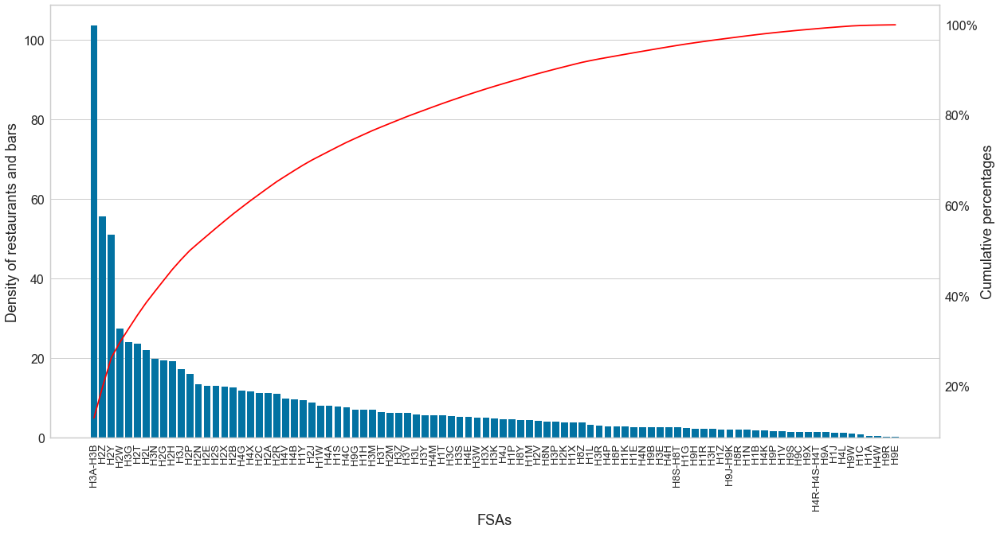

In [23]:
pareto_chart(df_env, 'RestaurantBar', 'Density of restaurants and bars')

The distribution is not uniform. Three FSAs (H3A-H3B, H2Z and H2Y) have a much higher density than the others and represent 26% of the total (for 3% of the FSAs). They are located in Montreal Downtown. H3A-H3B reaches a density of 104 restaurants and bars per km² while the median is 5 and the mean is 9.

Let's see a histogram of the PPS in the Island of Montreal.

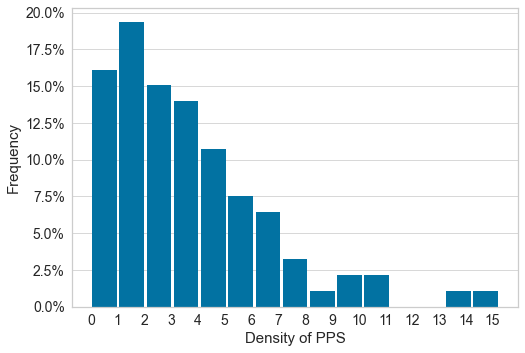

In [24]:
plot_hist(df_env, 'PPS', 15, 0, 'Density of PPS')

The majority of the FSAs has a density between 0 and 4 PPS per km², while there are few ones with a density between 13 and 15.

### Population dataset

Let's see a pareto chart of the density of population in the Island of Montreal.

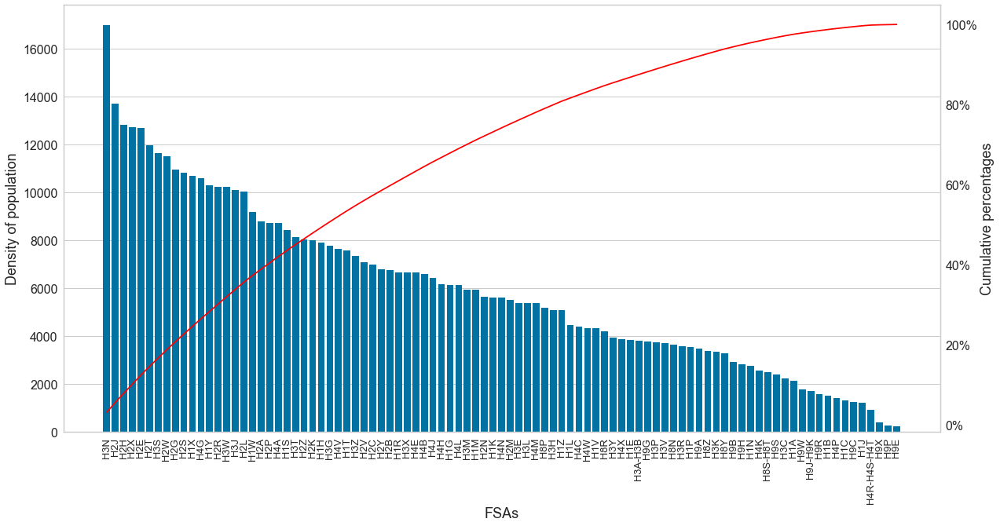

In [25]:
pareto_chart(df_pop, 'Population', 'Density of population')

The distribution is not uniform with 18% of the FSAs (the top 17) that represents 35.6% of the population. The H3N FSA has a much higher density of population than the other FSAs, with a value of 16 973 people per km², while the median value is 5 614 and the mean value 5 974. On the contrary, some FSAs have a density around 300 people per km².

Let's see a histogram of the median age of the population in the Island of Montreal.

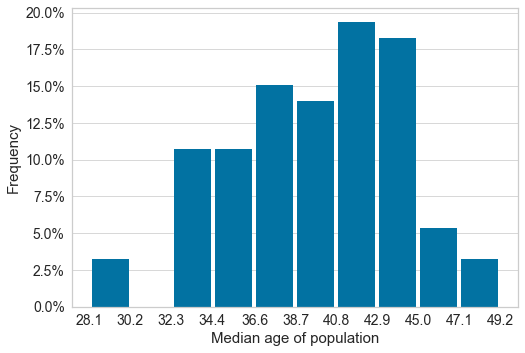

In [26]:
plot_hist(df_pop, 'Age', 10, 1, 'Median age of population')

The majority of the FSAs (around 40%) has a median age between 41 and 45 years of age. There are around 3% of the FSAs that have a quite young population, with a median age between 28 and 30 years of age.

### Housing dataset

Let's see a pareto chart of the average value of the properties in the Island of Montreal.

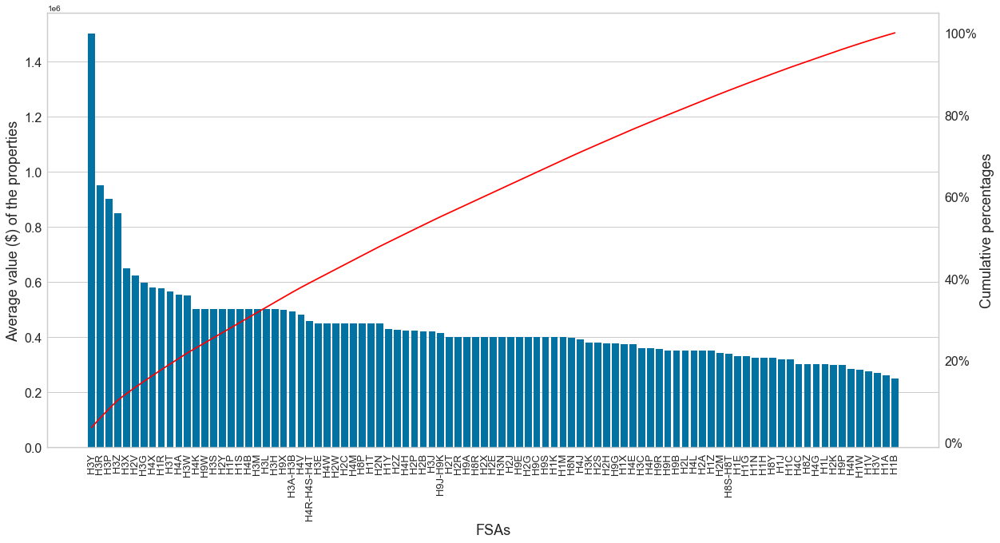

In [27]:
pareto_chart(df_hous, 'Value($)', 'Average value ($) of the properties')

Again, the distribution is not uniform. The H3N FSA alone represents 3.7% of the total value of the properties, with an average value of 1 500 249 CAD, which is much higher than the other FSAs. The median average value is 400 532 CAD and the mean average value is 436 497 CAD. 4% of the FSAs (the top 4) represent 10% of the total value.

Let's see a histogram of the average number of rooms in the dwellings in the Island of Montreal.

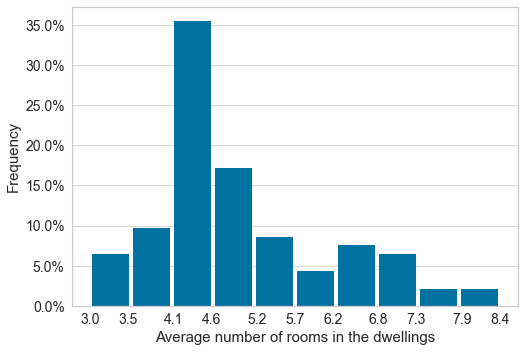

In [28]:
plot_hist(df_hous, 'NbRooms', 10, 1, 'Average number of rooms in the dwellings')

This value is between 3 and 8.4 across all the FSAs and the majority of the FSAs' dwellings (more than 35%) has between 4.1 and 4.6 rooms on average.

# Clustering <a name="clustering"></a>

Three different clustering models (K-Means, DBSCAN and agglomerative clustering) are used and compared for this project. For each of them, a parameters selection is performed. Before applying any clustering model, a data standardization is required. It scales the data with zero mean and unit variance.

In [29]:
silhouette_env = {}
silhouette_pop = {}
silhouette_hous = {}
calinski_env = {}
calinski_pop = {}
calinski_hous = {}

## K-Means

K-Means model is an iterative algorithm that divides the data into k non-overlapping subsets (clusters) without any cluster-internal structure. It identifies k number of centroids (arithmetic mean of all the data points that belong to a cluster) and then allocates every data point to the nearest cluster, while keeping the centroids as small as possible. Data points within a cluster are very similar while also being very different across different clusters.

The number of clusters k has to be given as a parameter for this model. A common way to choose the optimal number of clusters is to use the elbow method. It consists in running the clustering across different values of k and look at the graph of distortion versus k. The right value for the number of clusters is for the elbow point (where the rate of decrease sharply shifts). The KElbowVisualizer from Yellowbrick, which implements the elbow method, is used for the three datasets. Finally, using the number of clusters identified with the elbow method, the K-Means approach is implemented.

In [30]:
def apply_kmeans(df):
    # Identify the optimal number of clusters for the K-Means approach and implement it
    # Data scaling (making sure to drop potential columns with cluster labels for modelling)
    cluster_columns = []
    for column in df.columns:
        if 'Cluster' in column:
            cluster_columns.append(column)
    X = StandardScaler().fit_transform(df.drop(columns=cluster_columns).set_index('FSA'))
    
    # Get the optimal number of clusters for KMeans using the elbow method
    visualizer = KElbowVisualizer(KMeans(), k=(1,10), metric='distortion', timings=False).fit(X)
    k_cluster = visualizer.elbow_value_
    visualizer.show()
    
    # Run KMeans model and get the clusters label
    kmeans = KMeans(n_clusters=k_cluster, init='k-means++', n_init=15).fit(X)
    df['Cluster_kmeans'] = kmeans.labels_
    
    # Get the silhouette and calinski-harabaz scores to measure and compare the performance
    silhouette = metrics.silhouette_score(X, kmeans.labels_)
    calinski = metrics.calinski_harabasz_score(X, kmeans.labels_)
    
    return df, silhouette, calinski

Environment


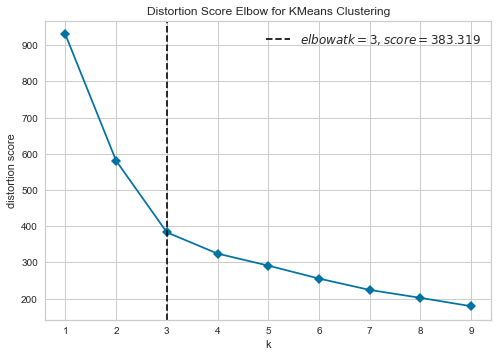

In [82]:
# Apply K-Means function for environment dataset
print('Environment')
df_env, silhouette_env['kmeans'], calinski_env['kmeans'] = apply_kmeans(df_env)

Population


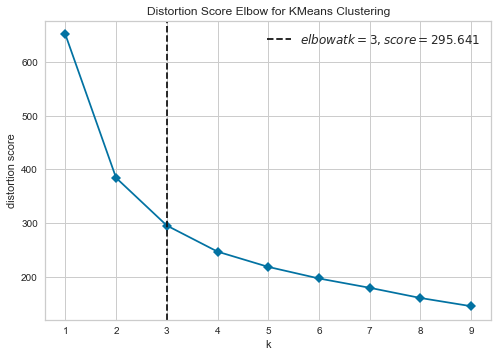

In [83]:
# Apply K-Means function for population dataset
print('Population')
df_pop, silhouette_pop['kmeans'], calinski_pop['kmeans'] = apply_kmeans(df_pop)

Housing


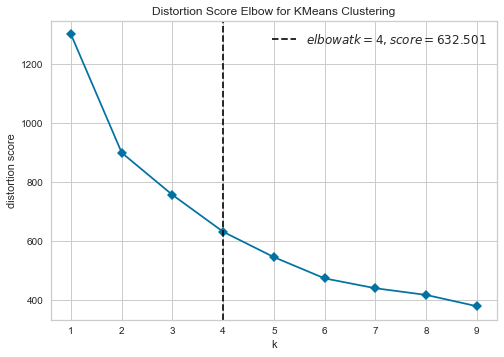

In [89]:
# Apply K-Means function for housing dataset
print('Housing')
df_hous, silhouette_hous['kmeans'], calinski_hous['kmeans'] = apply_kmeans(df_hous)

## DBSCAN

DBSCAN model is a density-based spatial clustering of applications with noise. It locates regions of high density, separated from one another by regions of low density, and separates outliers. It gives arbitrary-shaped clusters and not spherical ones, so there can be clusters within clusters.

The maximum distance between two samples for one to be considered as in the neighborhood of the other is an input of this algorithm. It is represented as the radius of the neighborhood and if there are enough points within this distance, it is a dense area. Another input of this algorithm is the number of samples in a neighborhood for a point to be considered as a core point. This is the minimum number of neighbors to define a cluster. This second parameter is set to 2 because having a cluster with two FSAs is not a problem for this project. On the other hand, having outliers should be avoided because all FSAs must belong to a cluster. So the first parameter (eps) is chosen as the value that gives the minimum number of outliers and more than one cluster. Finally, the DBSCAN approach is implemented with these selected parameters.

In [35]:
def get_dbscan_parameters(df, min_pts):
    # Get the optimal parameters for DBSCAN
    eps_min = 0.1
    eps_max = 3.2
    step = 0.01

    # Data scaling (making sure to drop potential columns with cluster labels for modelling)
    cluster_columns = []
    for column in df.columns:
        if 'Cluster' in column:
            cluster_columns.append(column)
    X = StandardScaler().fit_transform(df.drop(columns=cluster_columns).set_index('FSA'))
    
    # Determine the optimal value for eps
    nb_outliers = []
    nb_clusters = []
    EPS = np.arange(eps_min, eps_max, step)
    for eps in EPS:
        dbscan = DBSCAN(eps=eps, min_samples=min_pts, metric='euclidean').fit(X)
        unique, counts = np.unique(dbscan.labels_, return_counts=True)
        value_counts = np.asarray((unique, counts)).T
        if -1 in value_counts: # if there are outliers
            nb_outliers.append(value_counts[0][1])
            nb_clusters.append(value_counts.shape[0] - 1)
        else: # if no outliers
            nb_outliers.append(0)
            nb_clusters.append(value_counts.shape[0])

    # Get the best value for eps (minimum number of outliers and more than one cluster)
    eps = EPS[[i for i,v in enumerate(nb_clusters) if v > 1][-1]]
    
    # Plot
    fig, ax1 = plt.subplots()
    # Number of outliers
    ax1.set_xlabel('eps', fontsize=16)
    ax1.set_ylabel('Number of outliers', color='r', fontsize=16)
    ax1.plot(EPS, nb_outliers, 'r-')
    ax1.tick_params(axis='y', labelcolor='r', labelsize=13)
    ax1.tick_params(labelsize=13)
    # Show the selected point
    plt.axvline(x=eps, color='k', linestyle='--')
    y1 = nb_outliers[np.where(EPS == eps)[0][0]]
    left, right = plt.xlim()
    plt.axhline(y=y1, xmin=0, xmax=eps/right, color='k', linestyle='--')
    # Number of clusters
    ax2 = ax1.twinx()
    ax2.set_ylabel('Number of clusters', color='b', fontsize=16)
    ax2.plot(EPS, nb_clusters, 'b-')
    ax2.tick_params(axis='y', labelcolor='b', labelsize=13)
    ax2.tick_params(labelsize=13)
    ax2.grid(False)
    # Show the selected point
    y2 = nb_clusters[np.where(EPS == eps)[0][0]]
    plt.axhline(y=y2, xmin=eps/right, xmax=1, color='k', linestyle='--')
    plt.show()
    
    
    return eps

In [36]:
def apply_dbscan(df, eps, min_pts):
    # Implement the DBSCAN approach
    # Data scaling (making sure to drop potential columns with cluster labels for modelling)
    cluster_columns = []
    for column in df.columns:
        if 'Cluster' in column:
            cluster_columns.append(column)
    X = StandardScaler().fit_transform(df.drop(columns=cluster_columns).set_index('FSA'))
    # Run DBSCAN model and get the clusters label
    dbscan = DBSCAN(eps=eps, min_samples=min_pts, metric='euclidean').fit(X)
    df['Cluster_DBSCAN'] = dbscan.labels_
    # Get the silhouette and calinski-harabaz scores to measure and compare the performance
    silhouette = metrics.silhouette_score(X, dbscan.labels_)
    calinski = metrics.calinski_harabasz_score(X, dbscan.labels_)
    
    return df, silhouette, calinski

Environment


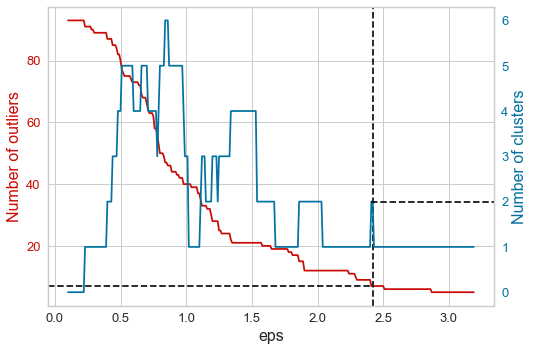

Population


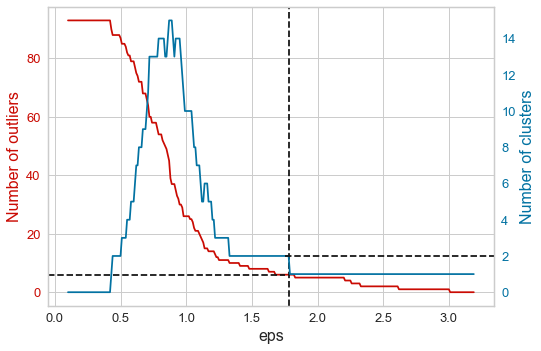

Housing


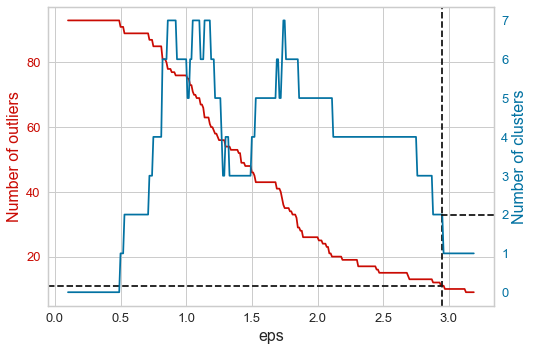

In [37]:
min_pts = 2

# Get the eps value for each dataset
print('Environment')
eps_env = get_dbscan_parameters(df_env, min_pts)
print('Population')
eps_pop = get_dbscan_parameters(df_pop, min_pts)
print('Housing')
eps_hous = get_dbscan_parameters(df_hous, min_pts)

# Run the DBSCAN model for each dataset with the identified parameters
df_env, silhouette_env['DBSCAN'], calinski_env['DBSCAN'] = apply_dbscan(df_env, eps_env, min_pts)
df_pop, silhouette_pop['DBSCAN'], calinski_pop['DBSCAN'] = apply_dbscan(df_pop, eps_pop, min_pts)
df_hous, silhouette_hous['DBSCAN'], calinski_hous['DBSCAN'] = apply_dbscan(df_hous, eps_hous, min_pts)

## Agglomerative clustering

Agglomerative clustering is one of the two types of hierarchical clustering. Hierarchical clustering algorithms build a hierarchy of clusters where each node is a cluster, constituted of the clusters of its daughter nodes. Divisive clustering has a top-down strategy because it starts from a large cluster with every data points to smaller pieces of one data point. Agglomerative clustering, on the contrary, has a bottom-up strategy. Its starts with each observation in its own cluster to merge them into larger clusters and finally get a cluster containing all observations. The agglomerative clustering constructs a distance matrix and merge the two closest clusters at each step.

A good visualization of hierarchical clustering is dendrograms. It shows each merge as a horizontal line and its y-coordinate shows the similarity of the two clusters that were merged. The larger the vertical lines in the dendrogram, the further away the clusters are from each other. To get the optimal number of clusters, we generally set the threshold in such a way that it cuts the tallest vertical line. This is the method we apply here for the three datasets. Finally, using the number of clusters identified with the dendrograms, the agglomerative clustering approach is implemented.

In [38]:
def plot_dendrogram(df, title, select=None):
    # Plot dendrograms with the potential identified threshold that cuts the tallest vertical line
    # Data scaling (making sure to drop potential columns with cluster labels for modelling)
    cluster_columns = []
    for column in df.columns:
        if 'Cluster' in column:
            cluster_columns.append(column)
    X = StandardScaler().fit_transform(df.drop(columns=cluster_columns).set_index('FSA'))

    plt.figure()
    plt.grid(axis='x')
    plt.title('Dendrogram - ' + title)
    plt.xlabel('Samples', fontsize=16)
    plt.ylabel('Distance', fontsize=16)
    plt.xticks(fontsize=13)
    plt.yticks(fontsize=13)
    dend = shc.dendrogram(shc.linkage(X, method='ward'))
    if select is not None:
        plt.axhline(y=select, color='m', linestyle='--')
        
        
def apply_agglomerative(df, n_cluster):
    # Implement the agglomerative clustering
    # Data scaling (making sure to drop potential columns with cluster labels for modelling)
    cluster_columns = []
    for column in df.columns:
        if 'Cluster' in column:
            cluster_columns.append(column)
    X = StandardScaler().fit_transform(df.drop(columns=cluster_columns).set_index('FSA'))
    # Run Agglomerative clustering model and get the clusters label
    agglo = AgglomerativeClustering(n_clusters=n_cluster, linkage='ward').fit(X)
    df['Cluster_Agglomerative'] = agglo.labels_
    # Get the silhouette score to measure and compare the performance
    silhouette = metrics.silhouette_score(X, agglo.labels_)
    calinski = metrics.calinski_harabasz_score(X, agglo.labels_)
    
    return df, silhouette, calinski

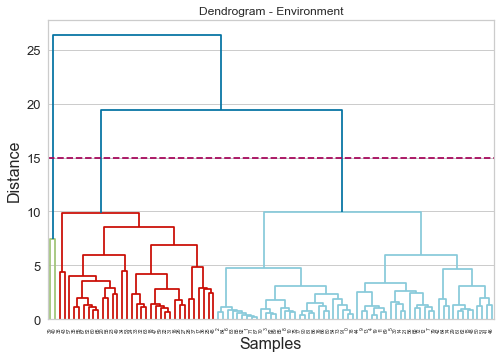

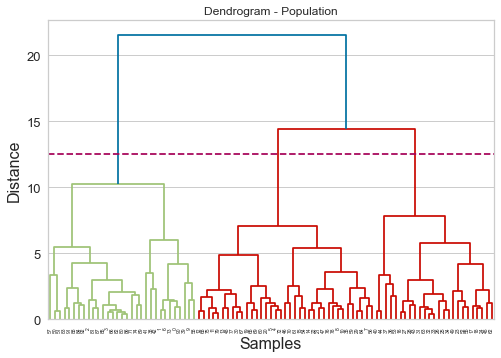

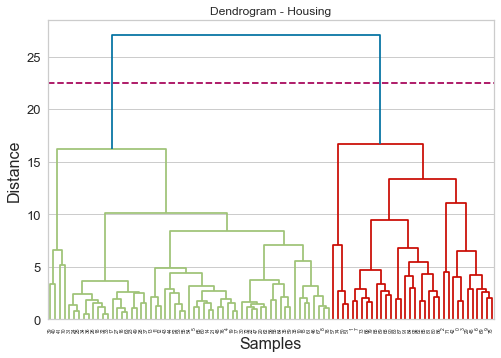

In [39]:
#Plot the dendrograms for each dataset with the identified thresholds
plot_dendrogram(df_env, 'Environment', 15) # threshold that cuts the tallest vertical line
plot_dendrogram(df_pop, 'Population', 12.5) # threshold that cuts the tallest vertical line
plot_dendrogram(df_hous, 'Housing', 22.5) # threshold that cuts the tallest vertical line

# Implement the agglomerative clustering for each dataset with the identified number of clusters
df_env, silhouette_env['AgglomerativeClustering'], calinski_env['AgglomerativeClustering'] = apply_agglomerative(df_env, 3)
df_pop, silhouette_pop['AgglomerativeClustering'], calinski_pop['AgglomerativeClustering'] = apply_agglomerative(df_pop, 3)
df_hous, silhouette_hous['AgglomerativeClustering'], calinski_hous['AgglomerativeClustering'] = apply_agglomerative(df_hous, 2)

# Comparison between the models <a name="comparison"></a>

To evaluate and compare the models, metrics like the silhouette score or the Calinski-Harabaz index can be used. The silhouette score, or silhouette coefficient, measures how well samples are clustered with other samples that are similar to each other. It is calculated using the mean intra-cluster distance, i.e the average distance between each point within a cluster, and the mean nearest-cluster distance, i.e the average distance between all clusters. The silhouette score varies between -1 and 1. A score of 1 means the cluster is dense and well-separated than other clusters; a score of 0 represents overlapping clusters with samples very close to the decision boundary of the neighboring clusters; a value of -1 means the clusters are assigned in the wrong way. The Calinski-Harabaz index, also known as the variance ratio criterion, is defined as the ratio between the within-cluster dispersion and the between-cluster dispersion. The score is not bounded. The higher the score is, the better the clustering is.

In [90]:
print('Silhouette score - Environment data frame:\n', silhouette_env, '\n')
print('Silhouette score - Population data frame:\n', silhouette_pop, '\n')
print('Silhouette score - Housing data frame:\n', silhouette_hous, '\n')
print('Calinski-Harabaz index - Environment data frame:\n', calinski_env, '\n')
print('Calinski-Harabaz index - Population data frame:\n', calinski_pop, '\n')
print('Calinski-Harabaz index - Housing data frame:\n', calinski_hous, '\n')

Silhouette score - Environment data frame:
 {'kmeans': 0.3328730383472287, 'DBSCAN': 0.3381758873661492, 'AgglomerativeClustering': 0.3431280318349367} 

Silhouette score - Population data frame:
 {'kmeans': 0.2821871930439877, 'DBSCAN': 0.2616650344116355, 'AgglomerativeClustering': 0.2517048985185575} 

Silhouette score - Housing data frame:
 {'kmeans': 0.39467955746722694, 'DBSCAN': 0.24192014263814923, 'AgglomerativeClustering': 0.31482489414088816} 

Calinski-Harabaz index - Environment data frame:
 {'kmeans': 64.21524422525569, 'DBSCAN': 18.496892185212726, 'AgglomerativeClustering': 61.80819380573773} 

Calinski-Harabaz index - Population data frame:
 {'kmeans': 54.045742495088405, 'DBSCAN': 9.08646029584016, 'AgglomerativeClustering': 48.18650682982831} 

Calinski-Harabaz index - Housing data frame:
 {'kmeans': 31.459839539354764, 'DBSCAN': 7.565677929501007, 'AgglomerativeClustering': 35.704992269250674} 



The metrics show, especially with the Calinski-Harabz index, that the DBSCAN algorithm seems to give poorer results than the two other algorithms, for all the three datasets. This is in line with the observations made at the time of the parameters selection. Indeed, the DBSCAN model identifies outliers, whereas the problem here requires all the FSAs to be clustered to have a portrait of the Island of Montreal as a whole. The DBSCAN algorithm is not suitable for this problem, therefore only the K-Means and the agglomerative clustering are considered in the following sections.

The silhouette scores and Calinski-Harabez indexes for K-Means and agglomerative clustering are quite similar. For the environment dataset, the silhouette score is the best for the agglomerative clustering, while the Calinski-Harabaz index is the best for K-Means. For the population dataset, both the silhouette score and Calinski-Harabaz index are the best for K-Means. Finally, for the housing dataset, the silhouette score is the best for K-Means, while the Calinski-Harabaz index is the best for the agglomerative clustering. Both scores do not really help to determine the best algorithm in our context, except for the population dataset where the K-Means approach seems to be more efficient.

To have a better understanding of the performances of the two approaches, the results of the clustering are visualized. To do so, a linear dimensionality reduction is performed using Singular Value Decomposition of the data. It provides a projection in a lower dimensional space and allows to visualize the results in two dimensions.

In [124]:
def plot_results(df, method, clusters, title):
    # Perform a linear dimensionality reduction to plot a 2D projection of the clustering results
    method_columns = {'K-Means': 'Cluster_kmeans',
                      'DBSCAN': 'Cluster_DBSCAN',
                      'Agglomerative Clustering': 'Cluster_Agglomerative'}
    # Data scaling (making sure to drop potential columns with cluster labels for PCA)
    cluster_columns = []
    for column in df.columns:
        if 'Cluster' in column:
            cluster_columns.append(column)
    X = StandardScaler().fit_transform(df.drop(columns=cluster_columns).set_index('FSA'))

    pca = PCA(n_components=2).fit(X)
    pca_2d = pca.transform(X)
    
    colors = ['r', 'b', 'g', 'c', 'k']
    legend = []
    for n in clusters:
            if n == -1:
                legend.append('Outliers')
            else:
                legend.append('Cluster ' + str(n))
    if len(clusters) == 2:
        for i in range(pca_2d.shape[0]):
            if df.loc[i, method_columns[method]] == clusters[0]:
                ax0 = plt.scatter(pca_2d[i,0], pca_2d[i,1], c=colors[0], marker='o')
            if df.loc[i, method_columns[method]] == clusters[1]:
                ax1 = plt.scatter(pca_2d[i,0], pca_2d[i,1], c=colors[1], marker='o')
        plt.legend([ax0, ax1], legend, fontsize=13)
    if len(clusters) == 3:
        for i in range(pca_2d.shape[0]):
            if df.loc[i, method_columns[method]] == clusters[0]:
                ax0 = plt.scatter(pca_2d[i,0], pca_2d[i,1], c=colors[0], marker='o')
            if df.loc[i, method_columns[method]] == clusters[1]:
                ax1 = plt.scatter(pca_2d[i,0], pca_2d[i,1], c=colors[1], marker='o')
            if df.loc[i, method_columns[method]] == clusters[2]:
                ax2 = plt.scatter(pca_2d[i,0], pca_2d[i,1], c=colors[2], marker='o')
        plt.legend([ax0, ax1, ax2], legend, fontsize=13)
    if len(clusters) == 4:
        for i in range(pca_2d.shape[0]):
            if df.loc[i, method_columns[method]] == clusters[0]:
                ax0 = plt.scatter(pca_2d[i,0], pca_2d[i,1], c=colors[0], marker='o')
            if df.loc[i, method_columns[method]] == clusters[1]:
                ax1 = plt.scatter(pca_2d[i,0], pca_2d[i,1], c=colors[1], marker='o')
            if df.loc[i, method_columns[method]] == clusters[2]:
                ax2 = plt.scatter(pca_2d[i,0], pca_2d[i,1], c=colors[2], marker='o')
            if df.loc[i, method_columns[method]] == clusters[3]:
                ax3 = plt.scatter(pca_2d[i,0], pca_2d[i,1], c=colors[3], marker='o')
        plt.legend([ax0, ax1, ax2, ax3], legend, fontsize=13)
    plt.title(method + ' - ' + title)
    plt.xlabel('Principal Component 1', fontsize=14)
    plt.ylabel('Principal Component 2', fontsize=14)
    plt.xticks(fontsize=13)
    plt.yticks(fontsize=13)
    print('Percentage of information carried by the dimension-reduced data: ' +
          str(round(pca.explained_variance_ratio_.sum()*100, 2)) + ' %')
    plt.show()

Percentage of information carried by the dimension-reduced data: 73.23 %


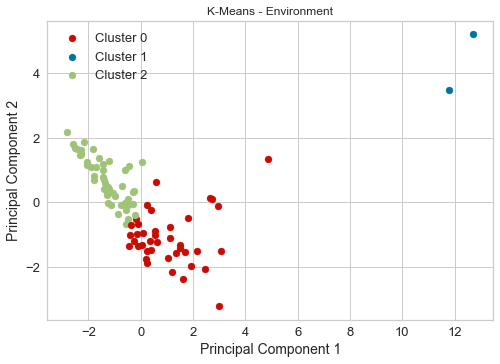

Percentage of information carried by the dimension-reduced data: 73.23 %


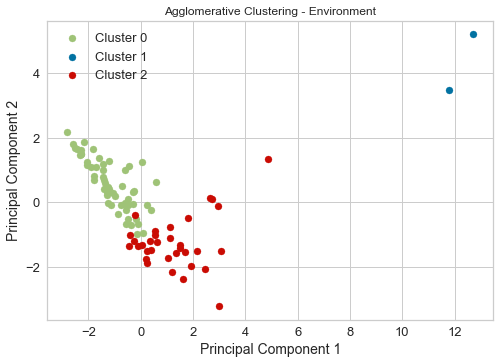

Percentage of information carried by the dimension-reduced data: 79.88 %


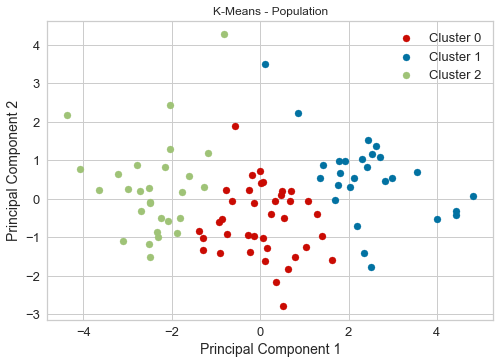

Percentage of information carried by the dimension-reduced data: 79.88 %


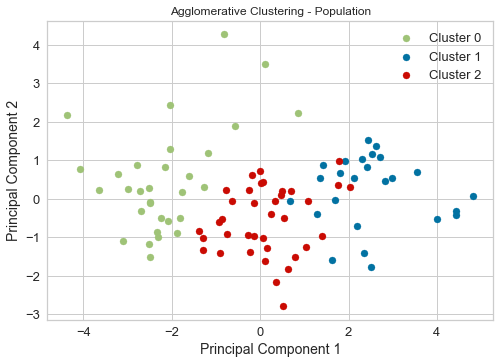

Percentage of information carried by the dimension-reduced data: 61.61 %


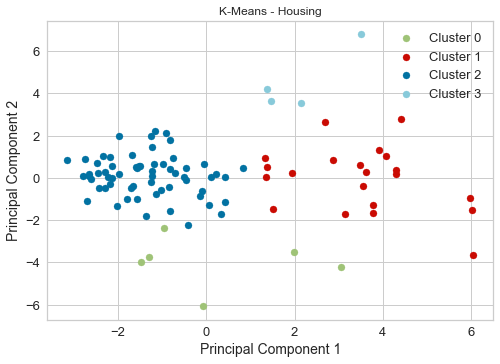

Percentage of information carried by the dimension-reduced data: 61.61 %


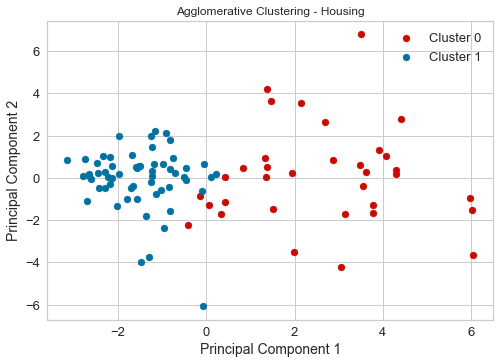

In [123]:
# Plot the 2D projection of the clustering results of K-Means and agglomerative clustering for the three datasets
plot_results(df_env, 'K-Means', [0, 1, 2], 'Environment')
plot_results(df_env, 'Agglomerative Clustering', [0, 1, 2], 'Environment')
plot_results(df_pop, 'K-Means', [0, 1, 2], 'Population')
plot_results(df_pop, 'Agglomerative Clustering', [0, 1, 2], 'Population')
plot_results(df_hous, 'K-Means', [0, 1, 2, 3], 'Housing')
plot_results(df_hous, 'Agglomerative Clustering', [0, 1], 'Housing')

The two dimensions projection for the environment dataset highlights that the points from the two biggest clusters obtained with the agglomerative clustering are quite mixed, whereas the clusters obtained with the K-Means method are fairly distinct. For the population dataset, the same observation can be made. As the number of clusters built by the two approaches is different for the housing dataset, it is difficult to compare the resulting clusters. However, according to the two dimensions projection they seem well separated in both cases.

In conclusion, in the context of this project the K-Means model and the agglomerative clustering provide good results, whereas the DBSCAN approach is not able to build suitable clusters. In addition, as the clusters obtained with the K-Means model are well separated, this method is preferred to answer to our problematic.

# Clustering results <a name="results"></a>

The clusters obtained with the K-Means model are analyzed in details in order to identify the specifics of each cluster for the three datasets.

### Environment dataset

Let's look at the main descriptive statistics of the environment dataset and its three clusters.

In [125]:
df_env.describe().round(1)

,Walkscore,Bikescore,RestaurantBar,EntertainmentCulture,Sports,Outdoor,MetroStations,Daycare,PPS,PostSecondary,Cluster_kmeans,Cluster_DBSCAN,Cluster_Agglomerative
count,93.0,93.0,93.0,93.0,93.0,93.0,93.0,93.0,93.0,93.0,93.0,93.0,93.0
mean,53.6,69.7,8.6,3.3,1.7,1.4,0.3,4.1,3.6,0.7,1.1,-0.1,0.7
std,23.7,15.4,13.4,7.2,2.7,1.4,0.9,3.2,3.0,2.0,1.0,0.3,1.0
min,1.4,38.5,0.2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1.0,0.0
25%,36.1,58.1,2.2,0.6,0.6,0.5,0.0,1.4,1.6,0.0,0.0,0.0,0.0
50%,53.6,67.9,4.7,1.3,1.0,1.0,0.0,3.4,3.0,0.0,2.0,0.0,0.0
75%,72.3,85.1,9.7,2.3,1.8,1.8,0.4,5.3,5.0,0.5,2.0,0.0,2.0
max,96.7,98.7,103.5,39.2,20.8,6.9,6.9,13.9,15.2,14.7,2.0,1.0,2.0


In [126]:
df_env[df_env['Cluster_kmeans'] == 0].describe().round(1)

,Walkscore,Bikescore,RestaurantBar,EntertainmentCulture,Sports,Outdoor,MetroStations,Daycare,PPS,PostSecondary,Cluster_kmeans,Cluster_DBSCAN,Cluster_Agglomerative
count,40.0,40.0,40.0,40.0,40.0,40.0,40.0,40.0,40.0,40.0,40.0,40.0,40.0
mean,72.5,81.9,11.9,4.6,1.6,1.7,0.5,6.3,5.6,0.9,0.0,-0.0,1.6
std,13.5,10.5,9.1,7.3,1.5,1.4,0.6,2.4,3.2,1.3,0.0,0.4,0.8
min,45.5,62.2,1.2,0.0,0.0,0.0,0.0,2.8,0.0,0.0,0.0,-1.0,0.0
25%,61.7,73.2,5.5,1.3,0.6,0.7,0.0,4.8,3.7,0.0,0.0,0.0,2.0
50%,72.7,85.2,10.3,1.8,1.2,1.1,0.4,5.4,5.2,0.3,0.0,0.0,2.0
75%,81.6,90.6,14.0,5.1,2.0,2.0,0.8,8.1,6.9,1.0,0.0,0.0,2.0
max,95.1,98.7,51.0,39.2,5.0,5.2,1.9,11.0,15.2,4.5,0.0,1.0,2.0


In [127]:
df_env[df_env['Cluster_kmeans'] == 1].describe().round(1)

,Walkscore,Bikescore,RestaurantBar,EntertainmentCulture,Sports,Outdoor,MetroStations,Daycare,PPS,PostSecondary,Cluster_kmeans,Cluster_DBSCAN,Cluster_Agglomerative
count,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0,2.0
mean,95.6,84.8,79.5,37.4,17.3,5.8,4.8,13.8,2.7,12.5,1.0,-1.0,1.0
std,1.5,4.9,33.9,1.1,5.0,1.7,3.0,0.1,3.9,3.0,0.0,0.0,0.0
min,94.5,81.4,55.6,36.6,13.7,4.6,2.7,13.7,0.0,10.4,1.0,-1.0,1.0
25%,95.1,83.1,67.5,37.0,15.5,5.2,3.8,13.8,1.4,11.5,1.0,-1.0,1.0
50%,95.6,84.8,79.5,37.4,17.3,5.8,4.8,13.8,2.7,12.5,1.0,-1.0,1.0
75%,96.1,86.6,91.5,37.8,19.1,6.4,5.9,13.9,4.1,13.6,1.0,-1.0,1.0
max,96.7,88.3,103.5,38.2,20.8,6.9,6.9,13.9,5.5,14.7,1.0,-1.0,1.0


In [128]:
df_env[df_env['Cluster_kmeans'] == 2].describe().round(1)

,Walkscore,Bikescore,RestaurantBar,EntertainmentCulture,Sports,Outdoor,MetroStations,Daycare,PPS,PostSecondary,Cluster_kmeans,Cluster_DBSCAN,Cluster_Agglomerative
count,51.0,51.0,51.0,51.0,51.0,51.0,51.0,51.0,51.0,51.0,51.0,51.0,51.0
mean,37.2,59.6,3.2,1.0,1.1,1.0,0.1,1.9,2.2,0.2,2.0,-0.0,0.0
std,16.2,10.7,2.2,0.8,1.0,0.9,0.1,1.5,1.8,0.5,0.0,0.1,0.3
min,1.4,38.5,0.2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,-1.0,0.0
25%,29.6,51.6,1.6,0.4,0.6,0.3,0.0,0.8,1.1,0.0,2.0,0.0,0.0
50%,36.6,58.8,2.6,0.7,0.8,0.8,0.0,1.5,2.0,0.0,2.0,0.0,0.0
75%,48.8,66.6,4.5,1.3,1.5,1.3,0.0,2.6,3.0,0.2,2.0,0.0,0.0
max,68.6,85.2,9.8,3.3,5.5,3.7,0.5,7.2,10.9,2.9,2.0,0.0,2.0


The descriptive statistics confirm that the three clusters have different profiles. The cluster 1 has really high walk score and bike score and a very large density of each venue, except for PPS schools that is lower than cluster 0. The cluster 0 has medium walk score and bike score and a density of venues always higher than cluster 2 but much lower than cluster 1. According to these observations, the clusters can be described as following.

- Cluster 0: Medium environment
- Cluster 1: Very rich environment
- Cluster 2: Poor environment

Let's see a map of the clustered FSAs of the Island of Montreal based on the environment dataset.

In [129]:
env_map = folium.Map(location=[latitude, longitude], zoom_start=10, tiles=None)
folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(env_map)
folium.Choropleth(
    geo_data=mtl_grp_geo_json,
    data=df_env,
    columns=['FSA', 'Cluster_kmeans'],
    key_on='feature.properties.FSAGROUP',
    fill_color='RdYlBu',
    fill_opacity=0.7, 
    line_opacity=0.2,
    bins=[0, 1, 2, 3],
    legend_name='Cluster',
).add_to(env_map)

env_map

### Population dataset

Let's look at the main descriptive statistics of the population dataset and its three clusters.

In [130]:
df_pop.describe().round(1)

,Population,Age,Income,ChildlessCouples(%),FamiliesWithChildren(%),OnePerson(%),SeveralNoFamily(%),Cluster_kmeans,Cluster_DBSCAN,Cluster_Agglomerative
count,93.0,93.0,93.0,93.0,93.0,93.0,93.0,93.0,93.0,93.0
mean,5973.7,39.8,31445.0,20.9,35.9,37.7,5.4,0.9,-0.0,1.1
std,3525.8,4.5,7934.9,3.4,13.2,11.6,3.5,0.8,0.3,0.9
min,231.2,28.1,16811.0,14.0,10.3,14.7,1.3,0.0,-1.0,0.0
25%,3481.5,36.6,26338.0,18.6,25.8,28.5,2.5,0.0,0.0,0.0
50%,5614.2,39.9,30566.0,21.0,36.4,38.2,4.5,1.0,0.0,1.0
75%,8031.2,43.3,34344.0,23.0,46.9,45.9,7.4,2.0,0.0,2.0
max,16973.0,49.2,66500.0,28.8,62.3,62.7,15.8,2.0,1.0,2.0


In [131]:
df_pop[df_pop['Cluster_kmeans'] == 0].describe().round(1)

,Population,Age,Income,ChildlessCouples(%),FamiliesWithChildren(%),OnePerson(%),SeveralNoFamily(%),Cluster_kmeans,Cluster_DBSCAN,Cluster_Agglomerative
count,38.0,38.0,38.0,38.0,38.0,38.0,38.0,38.0,38.0,38.0
mean,5985.8,40.1,28643.2,19.3,38.8,37.2,4.7,0.0,0.0,1.9
std,2010.4,3.0,4570.3,2.2,7.1,6.2,1.5,0.0,0.0,0.4
min,1401.8,34.0,21258.0,14.0,25.8,23.6,2.4,0.0,0.0,0.0
25%,5097.8,38.3,24981.8,17.7,32.8,33.2,3.7,0.0,0.0,2.0
50%,6139.4,40.0,27850.0,19.9,38.6,36.9,4.6,0.0,0.0,2.0
75%,7068.1,42.2,31918.0,20.9,43.7,42.5,5.6,0.0,0.0,2.0
max,10236.2,48.1,40843.0,23.2,52.8,46.1,9.1,0.0,0.0,2.0


In [132]:
df_pop[df_pop['Cluster_kmeans'] == 1].describe().round(1)

,Population,Age,Income,ChildlessCouples(%),FamiliesWithChildren(%),OnePerson(%),SeveralNoFamily(%),Cluster_kmeans,Cluster_DBSCAN,Cluster_Agglomerative
count,27.0,27.0,27.0,27.0,27.0,27.0,27.0,27.0,27.0,27.0
mean,9299.8,35.1,28537.0,19.4,20.9,50.0,9.7,1.0,0.0,1.0
std,3549.0,2.9,7126.9,3.0,7.2,6.0,3.0,0.0,0.5,0.4
min,2241.8,28.1,16811.0,15.0,10.3,37.8,4.5,1.0,-1.0,0.0
25%,7888.9,34.2,25355.0,17.0,15.9,46.9,7.7,1.0,0.0,1.0
50%,10240.1,34.8,28670.0,19.2,20.1,49.9,9.0,1.0,0.0,1.0
75%,11571.9,36.7,31968.5,21.2,23.7,53.6,11.6,1.0,0.0,1.0
max,16973.0,42.3,51548.0,26.9,39.0,62.7,15.8,1.0,1.0,2.0


In [133]:
df_pop[df_pop['Cluster_kmeans'] == 2].describe().round(1)

,Population,Age,Income,ChildlessCouples(%),FamiliesWithChildren(%),OnePerson(%),SeveralNoFamily(%),Cluster_kmeans,Cluster_DBSCAN,Cluster_Agglomerative
count,28.0,28.0,28.0,28.0,28.0,28.0,28.0,28.0,28.0,28.0
mean,2750.1,44.0,38051.5,24.6,46.5,26.6,2.3,2.0,-0.1,0.0
std,1688.9,2.5,8499.3,2.2,10.9,9.5,0.9,0.0,0.3,0.0
min,231.2,37.1,28969.0,21.0,12.0,14.7,1.3,2.0,-1.0,0.0
25%,1456.0,42.7,32332.0,23.0,40.7,21.5,1.7,2.0,0.0,0.0
50%,2685.5,44.5,36488.8,23.9,49.7,24.7,2.0,2.0,0.0,0.0
75%,3774.4,44.8,40148.5,26.1,53.1,31.6,2.7,2.0,0.0,0.0
max,6774.5,49.2,66500.0,28.8,62.3,55.4,4.5,2.0,0.0,0.0


The descriptive statistics confirm that the three clusters have different profiles. The cluster 1 has a high density of population, the cluster 0 a medium one and the cluster 2 a low one. The cluster 1 has also the youngest population, while the cluster 2 has the oldest. About the median income, the clusters 0 and 1 are quite similar, but the cluster 2 has a median income much higher than the two others. The cluster 1 has a majority of people living alone, about half of the population, and more people living with other non-family members than the other clusters. In addition, it has less families with children. The cluster 2 has a majority of families with children, almost half of the population, and the most of childless couples. It has the least of people living alone or with non-family members. Finally, the cluster 0 has almost as many people living alone as families with children, which are the majority of the population. It has less couples without children. According to these observations, the clusters can be described as following.

- Cluster 0: Medium density, average age, medium income, mixed types of families
- Cluster 1: High density, young population, medium income, majority (half) of people living alone and the most people living with non-family members
- Cluster 2: Low density, old population, high income, majority (almost half) of families with children and the most childless couples

Let's see a map of the clustered FSAs of the Island of Montreal based on the population dataset.

In [134]:
pop_map = folium.Map(location=[latitude, longitude], zoom_start=10, tiles=None)
folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(pop_map)
folium.Choropleth(
    geo_data=mtl_grp_geo_json,
    data=df_pop,
    columns=['FSA', 'Cluster_kmeans'],
    key_on='feature.properties.FSAGROUP',
    fill_color='RdYlBu',
    fill_opacity=0.7, 
    line_opacity=0.2,
    bins=[0, 1, 2, 3],
    legend_name='Cluster',
).add_to(pop_map)

pop_map

### Housing dataset

Let's look at the main descriptive statistics of the housing dataset and its four clusters.

In [135]:
df_hous.describe().round(1)

,NbDwellings,Value($),NbRooms,Rental(%),DetachedHouse(%),AttachedHouse(%),Apartment(%),1960OrBefore(%),1961-1980(%),1981-1990(%),1991-2000(%),2001-2005(%),2006-2010(%),2011-2016(%),Cluster_kmeans,Cluster_DBSCAN,Cluster_Agglomerative
count,93.0,93.0,93.0,93.0,93.0,93.0,93.0,93.0,93.0,93.0,93.0,93.0,93.0,93.0,93.0,93.0,93.0
mean,2834.2,436496.8,5.0,56.1,15.5,9.1,75.4,37.9,32.0,11.4,6.6,3.5,4.0,4.6,1.7,0.7,0.6
std,1899.2,165347.7,1.2,19.7,22.4,9.0,27.5,20.7,14.1,7.7,4.4,2.9,4.0,6.9,0.7,0.7,0.5
min,89.6,250531.0,3.0,10.3,0.0,0.1,4.9,2.6,4.2,1.2,0.6,0.3,0.0,0.0,0.0,-1.0,0.0
25%,1332.8,349661.0,4.2,42.1,0.4,2.8,65.0,20.2,20.7,6.5,4.0,1.8,1.8,1.6,1.0,1.0,0.0
50%,2442.6,400532.0,4.6,62.3,5.0,6.0,86.4,39.9,29.5,8.7,5.2,2.6,2.9,2.7,2.0,1.0,1.0
75%,3946.2,494159.5,5.5,70.2,21.5,13.4,96.1,52.7,41.5,13.9,7.7,4.5,4.3,4.6,2.0,1.0,1.0
max,7677.3,1500249.0,8.4,90.5,86.3,53.6,99.8,89.0,67.6,41.2,23.4,16.1,21.7,44.4,3.0,1.0,1.0


In [136]:
df_hous[df_hous['Cluster_kmeans'] == 0].describe().round(1)

,NbDwellings,Value($),NbRooms,Rental(%),DetachedHouse(%),AttachedHouse(%),Apartment(%),1960OrBefore(%),1961-1980(%),1981-1990(%),1991-2000(%),2001-2005(%),2006-2010(%),2011-2016(%),Cluster_kmeans,Cluster_DBSCAN,Cluster_Agglomerative
count,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0,6.0
mean,2016.3,424424.3,4.0,53.7,2.7,8.6,88.7,12.3,19.5,11.5,8.0,9.2,15.1,24.4,0.0,-1.0,0.7
std,1694.8,55034.6,0.8,16.2,3.5,9.7,12.7,8.1,8.9,8.7,5.8,5.1,5.6,15.7,0.0,0.0,0.5
min,361.1,358753.0,3.3,38.2,0.0,0.2,67.5,2.6,4.2,3.5,2.6,0.3,9.0,9.5,0.0,-1.0,0.0
25%,810.8,376253.8,3.4,42.2,0.0,1.3,82.7,6.1,16.9,6.3,4.0,8.5,10.3,13.2,0.0,-1.0,0.2
50%,1773.5,437756.5,3.7,47.2,1.2,4.9,92.4,12.0,20.8,9.2,5.6,9.7,14.6,17.9,0.0,-1.0,1.0
75%,2468.1,456214.6,4.4,68.1,4.7,14.1,98.7,18.4,24.9,13.2,12.7,11.0,20.0,38.1,0.0,-1.0,1.0
max,5000.0,494159.5,5.2,74.0,8.5,24.1,99.8,22.2,29.5,27.5,15.7,16.1,21.7,44.4,0.0,-1.0,1.0


In [137]:
df_hous[df_hous['Cluster_kmeans'] == 1].describe().round(1)

,NbDwellings,Value($),NbRooms,Rental(%),DetachedHouse(%),AttachedHouse(%),Apartment(%),1960OrBefore(%),1961-1980(%),1981-1990(%),1991-2000(%),2001-2005(%),2006-2010(%),2011-2016(%),Cluster_kmeans,Cluster_DBSCAN,Cluster_Agglomerative
count,21.0,21.0,21.0,21.0,21.0,21.0,21.0,21.0,21.0,21.0,21.0,21.0,21.0,21.0,21.0,21.0,21.0
mean,891.6,381020.9,6.4,28.7,49.2,16.2,34.7,20.9,37.7,19.2,10.1,5.1,4.0,3.1,1.0,0.6,0.0
std,521.9,70329.7,0.9,11.8,22.8,8.2,20.2,16.8,14.7,9.0,5.8,2.8,3.4,3.0,0.0,0.7,0.0
min,89.6,259561.0,4.7,10.3,3.6,4.3,4.9,3.7,9.2,7.6,2.3,1.6,0.0,0.0,1.0,-1.0,0.0
25%,568.5,324113.0,5.8,20.3,38.3,9.5,19.0,6.7,27.2,13.9,5.3,2.5,1.9,1.6,1.0,1.0,0.0
50%,909.9,375639.0,6.4,28.3,53.9,14.6,30.5,14.2,36.9,16.7,8.2,5.0,3.3,2.5,1.0,1.0,0.0
75%,1244.4,413596.7,7.0,37.6,65.6,20.8,48.5,32.7,47.1,21.1,13.9,6.1,4.8,3.2,1.0,1.0,0.0
max,1949.9,501665.0,8.4,53.4,86.3,39.2,81.9,62.5,67.6,41.2,23.4,12.0,17.0,12.7,1.0,1.0,0.0


In [138]:
df_hous[df_hous['Cluster_kmeans'] == 2].describe().round(1)

,NbDwellings,Value($),NbRooms,Rental(%),DetachedHouse(%),AttachedHouse(%),Apartment(%),1960OrBefore(%),1961-1980(%),1981-1990(%),1991-2000(%),2001-2005(%),2006-2010(%),2011-2016(%),Cluster_kmeans,Cluster_DBSCAN,Cluster_Agglomerative
count,62.0,62.0,62.0,62.0,62.0,62.0,62.0,62.0,62.0,62.0,62.0,62.0,62.0,62.0,62.0,62.0,62.0
mean,3665.2,421238.7,4.4,67.3,4.2,5.3,90.5,43.7,32.4,9.3,5.5,2.5,3.1,3.5,2.0,1.0,0.9
std,1705.6,106448.6,0.5,8.8,5.1,4.2,7.7,15.8,13.2,5.2,2.8,1.5,2.0,2.6,0.0,0.3,0.3
min,674.6,250531.0,3.0,50.8,0.0,0.1,65.0,9.9,7.7,2.4,1.6,0.4,0.6,0.3,2.0,-1.0,0.0
25%,2371.2,349514.8,4.1,61.5,0.3,2.3,84.9,34.3,20.8,6.3,3.7,1.5,1.7,1.7,2.0,1.0,1.0
50%,3257.6,400631.0,4.4,67.8,1.9,4.4,93.1,44.8,31.8,8.3,4.9,2.4,2.7,2.7,2.0,1.0,1.0
75%,4900.3,495319.5,4.8,72.1,6.9,7.1,97.0,53.4,41.0,10.1,6.5,3.3,3.6,4.5,2.0,1.0,1.0
max,7677.3,850402.0,5.6,90.5,21.6,18.3,99.7,76.4,67.5,31.0,18.5,7.9,10.7,11.9,2.0,1.0,1.0


In [139]:
df_hous[df_hous['Cluster_kmeans'] == 3].describe().round(1)

,NbDwellings,Value($),NbRooms,Rental(%),DetachedHouse(%),AttachedHouse(%),Apartment(%),1960OrBefore(%),1961-1980(%),1981-1990(%),1991-2000(%),2001-2005(%),2006-2010(%),2011-2016(%),Cluster_kmeans,Cluster_DBSCAN,Cluster_Agglomerative
count,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0
mean,1378.3,982356.2,7.2,28.7,34.0,31.4,34.6,76.8,15.1,3.0,2.4,1.3,0.7,0.8,3.0,0.5,0.0
std,72.7,382187.0,0.8,8.4,1.8,14.9,13.1,8.4,6.3,1.5,2.8,0.7,0.5,0.5,0.0,1.0,0.0
min,1324.9,579719.0,6.7,16.9,31.5,22.1,14.9,69.9,6.4,1.2,0.6,0.6,0.0,0.4,3.0,-1.0,0.0
25%,1331.8,819884.0,6.8,26.8,33.4,23.9,33.9,72.9,12.7,2.4,0.8,0.9,0.5,0.5,3.0,0.5,0.0
50%,1352.5,924728.5,6.9,30.6,34.6,25.0,40.4,74.1,17.2,3.0,1.2,1.1,0.8,0.6,3.0,1.0,0.0
75%,1399.0,1087200.8,7.4,32.5,35.3,32.5,41.0,78.1,19.6,3.6,2.8,1.5,0.9,0.8,3.0,1.0,0.0
max,1483.1,1500249.0,8.4,36.9,35.4,53.6,42.6,89.0,19.7,4.8,6.6,2.3,1.1,1.5,3.0,1.0,0.0


As for the two other datasets, the descriptive statistics confirm that the clusters have different profiles. The cluster 1 has a low density of dwellings, while the cluster 2 has a high one, the cluster 0 a medium high one and the cluster 3 a medium low one. The cluster 3 has a very high median value of dwellings, the cluster 1 a low value (more than 2.5 less than the cluster 3) and the clusters 0 and 2 are quite similar, with a medium value. About the average number of rooms per dwellings, the cluster 3 has a very high number of rooms, as would be expected since it is usually correlated with the price. The cluster 1 has less rooms than the cluster 3 but still a quite high number of rooms. The clusters 0 and 2 have a lower number of rooms, with cluster 2 above cluster 0. Then, the clusters 1 and 3 have more owners than tenants, while the cluster 2 has a large majority of tenants and the cluster 0 is pretty balanced. For the type of dwellings, more than 80\% of the dwellings are apartments for the clusters 0 and 2, whereas the cluster 3 is equally shared among detached houses, attached houses and apartments. The cluster 1 has almost half of dwellings that are detached houses and then a majority of apartments. Finally, for the year of construction, the cluster 3 has very old properties, the cluster 0 has quite recent ones and the clusters 1 and 2 have a majority of old ones. According to these observations, the clusters can be described as following.

- Cluster 0: Medium high density, medium value, low number of rooms, almost as many owners as tenants, mostly apartments, and recent properties
- Cluster 1: Low density, low value, high number of rooms, mainly owners, majority of detached houses, and quite old properties
- Cluster 2: High density, medium value, medium number of rooms, majority of tenants, mostly apartments, and old properties
- Cluster 3: Medium low density, very high value, very high number of rooms, mainly owners, equitably distributed types of dwellings, and very old properties

Let's see a map of the clustered FSAs of the Island of Montreal based on the housing dataset.

In [140]:
hous_map = folium.Map(location=[latitude, longitude], zoom_start=10, tiles=None)
folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(hous_map)
folium.Choropleth(
    geo_data=mtl_grp_geo_json,
    data=df_hous,
    columns=['FSA', 'Cluster_kmeans'],
    key_on='feature.properties.FSAGROUP',
    fill_color='RdYlBu',
    fill_opacity=0.7, 
    line_opacity=0.2,
    bins=[0, 1, 2, 3, 4],
    legend_name='Cluster',
).add_to(hous_map)

hous_map

# Discussion <a name="discussion"></a>

There are several approaches to perform clustering and the most suitable model for a specific project must be selected. In the context of our study, three algorithms are considered: K-Means, DBSCAN and agglomerative clustering. DBSCAN is an algorithm that automatically identifies outliers. It could be useful for some applications but it does not meet our needs for this project. All of the FSAs need to belong to a cluster and none of them must be considered as outlier. The DBSCAN approach could therefore be eliminated according to this observation, without even testing it. The DBSCAN model should then be used only if outliers are possible.

For the two other approaches, the parameters selection allows to have the best results. Both algorithms perform fairly equally but the detailed analysis of the results points out the K-Means model as the best regarding the goal of our study. To select the best model for a project, the choice must not be driven only by the model performance metrics. Indeed, the expected results for the application must also be considered.

# Conclusion <a name="conclusion"></a>

In this project, homogeneous clusters of neighborhoods of the Island of Montreal are built based on the environment, the population and the housing. The data required is collected from different sources, then cleaned and processed to be used for three clustering approaches: K-Means, DBSCAN and agglomerative clustering. After a parameters selection for each one, the three models and their results are compared and the K-Means approach is identified as the best for this study. The clusters thus obtained are described and analysed.

This study shows that the clusters obtained regarding the environment, the population and the housing are quite different, many neighborhoods are together for a specific category but not for the two others. However, there is always a distinction between the center and the periphery of the Island and more generally some areas are quite homogeneous regarding the three categories. In conclusion, even if some areas seem to be uniform, neighborhoods at a FSA scale needs to be considered to get a precise understanding of a specific location regarding the environment, the population or the housing.

This project could be improved by exploring some other directions. First, instead of considering three separated datasets, the main features from all the data sources could be considered as a whole and the clustering could be performed with all these features. It would give an overall profile of the Island of Montreal, taking into account the environment, the population and the housing. The data could also be refined. For example, real estate data could be collected to consider the actual sale price of properties, instead of their declared value, and the current  number of properties for sale or for rent. Another interesting path to explore could be the study of the evolution of neighborhoods over time. Historical data could be used to build clusters over time. This analysis would show how the neighborhoods' profiles evolves and how quickly it happens.